In [1]:
import scanpy as sc
from pathlib import Path
import pandas as pd
import squidpy as sq
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# from muon import prot as pt
# from muon import MuData
# import muon as mu
import numpy as np
from jax.config import config
from itertools import product
from datetime import datetime

config.update("jax_enable_x64", True)
# config.update("jax_platform_name", "cpu")
# JAX_PLATFORM_NAME = "cpu"
%load_ext autoreload
%autoreload 1
%load_ext lab_black

path_data = Path("/lustre/groups/ml01/workspace/moscot_paper/mapping")

In [2]:
scaler = StandardScaler()

adata_sc = sc.read(path_data / "adata_sc_processed.h5ad")
adata_p = sc.read(path_data / "adata_cite_processed.h5ad")
sc.pp.pca(adata_sc, n_comps=50)
sc.pp.pca(adata_p, n_comps=50)
adata_sc.obsm["X_pca_protein"] = adata_p.obsm["X_pca"].copy()
adata_sc.obsm["X_pca_protein_scaled"] = scaler.fit_transform(
    adata_p.obsm["X_pca"].copy()
)
adata_sc.obsm["X_pca"] = adata_p.obsm["X_pca"].copy()
adata_sc.obsm["X_pca_scaled"] = scaler.fit_transform(adata_p.obsm["X_pca"].copy())
# sc.pp.subsample(adata_sc, fraction=0.5)

In [3]:
adata_spatial = sc.read(path_data / "vizgen_liver/adata_result.h5ad")
adata_spatial.X = adata_spatial.layers["normalized"].copy()
sc.pp.pca(adata_spatial, n_comps=50)
spatial = adata_spatial.obsm["spatial"]
adata_spatial.obsm["spatial_scaled"] = (spatial - spatial.mean()) / spatial.std()
adata_spatial.obsm["X_pca_scaled"] = scaler.fit_transform(adata_spatial.obsm["X_pca"])
adata_spatial.obsm["X_pca_spatial_scaled"] = np.concatenate(
    [adata_spatial.obsm["X_pca_scaled"], adata_spatial.obsm["spatial_scaled"]], axis=1
)

In [4]:
import mplscience
import matplotlib.pyplot as plt

mplscience.available_styles()
mplscience.set_style(reset_current=True)
plt.rcParams["legend.scatterpoints"] = 1

['default', 'despine']


In [5]:
adata_spatial.var_names = [v.capitalize() for v in adata_spatial.var_names.values]

In [6]:
var_names = list(
    set(adata_sc.var_names.values).intersection(adata_spatial.var_names.values)
)
len(var_names)

336

/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


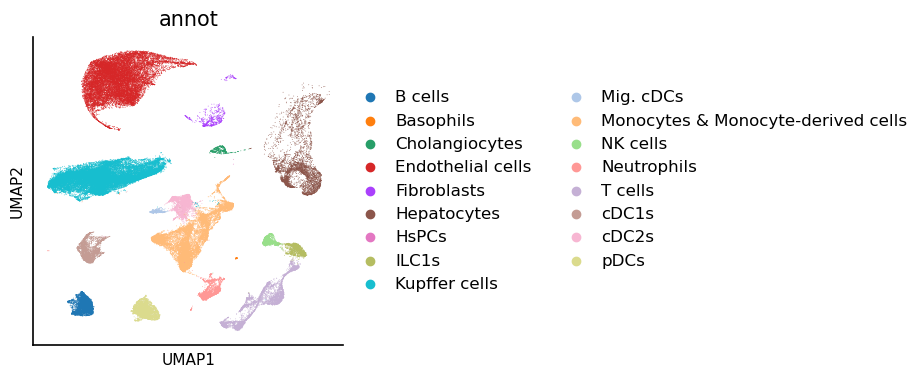

<Figure size 400x400 with 0 Axes>

In [7]:
sc.pl.umap(
    adata_sc,
    color=[
        # "n_counts",
        "annot",
    ],
)
plt.tight_layout()

/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


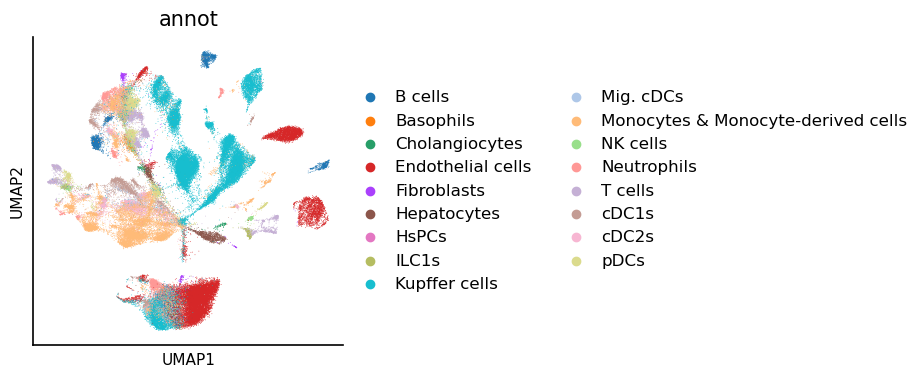

<Figure size 400x400 with 0 Axes>

In [8]:
sc.pl.umap(
    adata_p,
    color=["annot"],
)
plt.tight_layout()

In [9]:
from moscot.problems.space import MappingProblem

problem = (
    MappingProblem(adata_sc, adata_spatial).prepare(
        # batch_key="batch",
        sc_attr={"attr": "obsm", "key": "X_pca_scaled"},
        spatial_key={"attr": "obsm", "key": "X_pca_scaled"},
        # normalize=True,
        var_names=var_names,
        xy_callback_kwargs={"n_comps": 50},
    )
    # .solve(xy_callback_kwargs=alpha=0.5, epsilon=1e-2)
)
# joint_attr={
#     "x_attr": "obsm",
#     "x_key": "X_scanorama",
#     "y_attr": "obsm",
#     "y_key": "X_scanorama",
# },

/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/flax/core/frozen_dict.py:169: FutureWarning: jax.tree_util.register_keypaths is deprecated, and will be removed in a future release. Please use `register_pytree_with_keys()` instead.
  jax.tree_util.register_keypaths(
/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/docrep/decorators.py:43: SyntaxWarning: 'interpolation_parameters' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/docrep/decorators.py:43: SyntaxWarning: 'account_for_unbalancedness' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/docrep/decorators.py:43: SyntaxWarning: 'batch_size' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/p

INFO     Computing pca with `n_comps=50` for `xy` using `adata.X`                                                  


In [10]:
from datetime import datetime

start_time = datetime.now()
problem = problem.solve(
    alpha=0.1,
    rank=400,
    epsilon=0,
    initializer="k-means",
    max_iterations=30,
    threshold=1e-6,
)
end_time = datetime.now()

INFO     Solving problem OTProblem[stage='prepared', shape=(367235, 91040)].                                       
WARNING  Solver did not converge                                                                                   


In [12]:
print(end_time - start_time)

0:48:17.067747


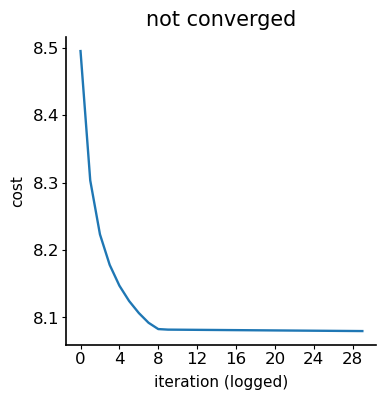

In [13]:
problem.problems[("src", "tgt")].solution.plot_costs()

In [14]:
problem.save(path_data / "output", overwrite=True)

INFO     Successfully saved the problem as                                                                         
         `/lustre/groups/ml01/workspace/moscot_paper/mapping/output/MappingProblem.pkl`                            


In [15]:
from anndata import AnnData

prot = adata_p[adata_sc.obs_names].X.A
spatial_prot = problem.problems[("src", "tgt")].solution.pull(
    prot,
    scale_by_marginals=True,
)
adata_spatial_prot = AnnData(
    np.array(spatial_prot), obs=adata_spatial.obs.copy(), obsm=adata_spatial.obsm.copy()
)
adata_spatial_prot.var_names = adata_p.var_names.copy()

/tmp/ipykernel_569919/129798072.py:8: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_spatial_prot = AnnData(


In [16]:
genes = ["Gja5", "Adgrg6", "Mmrn1", "Epcam", "Spp1"]
adata_sc[:, genes]

View of AnnData object with n_obs × n_vars = 91040 × 5
    obs: 'cluster', 'annot', 'sample', 'cell', 'digest', 'typeSample'
    var: 'n_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'annot_colors', 'hvg', 'pca', 'sample_colors'
    obsm: 'X_pca', 'X_umap', 'joint_pca', 'X_pca_protein', 'X_pca_protein_scaled', 'X_pca_scaled'
    varm: 'PCs'
    layers: 'counts'

In [17]:
from anndata import AnnData

gexp = adata_sc[adata_sc.obs_names, genes].X.A
spatial_gexp = problem.problems[("src", "tgt")].solution.pull(
    gexp,
    scale_by_marginals=True,
)
adata_spatial_gexp = AnnData(
    np.array(spatial_gexp), obs=adata_spatial.obs.copy(), obsm=adata_spatial.obsm.copy()
)
adata_spatial_gexp.var_names = genes

/tmp/ipykernel_569919/559117980.py:8: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_spatial_gexp = AnnData(


In [18]:
adata_spatial_prot.X.max()

0.9097567

In [19]:
adata_spatial_gexp.X.max()

0.21233921

In [20]:
adata_spatial_prot.obs["Cell_Type"] = adata_spatial.obs["Cell_Type"].copy()

In [21]:
dummy = pd.get_dummies(adata_sc.obs["annot"])

In [22]:
temp = problem[("src", "tgt")].pull(dummy, scale_by_marginals=False)
temp.shape

(367235, 17)

In [23]:
clusters = pd.Categorical([dummy.columns[i] for i in np.array(temp.argmax(1))])
clusters.value_counts()

B cells                                9603
Basophils                             14982
Cholangiocytes                        12494
Endothelial cells                     71076
Fibroblasts                            5423
Hepatocytes                           18506
HsPCs                                 12255
ILC1s                                  7960
Kupffer cells                         94902
Mig. cDCs                              8120
Monocytes & Monocyte-derived cells    37181
NK cells                               4011
Neutrophils                            7721
T cells                               10008
cDC1s                                 23097
cDC2s                                  7892
pDCs                                  22004
dtype: int64

In [24]:
adata_spatial_prot.obs["celltype_mapped"] = clusters

In [25]:
adata_spatial_prot.obs["celltype_mapped"].cat.categories

Index(['B cells', 'Basophils', 'Cholangiocytes', 'Endothelial cells',
       'Fibroblasts', 'Hepatocytes', 'HsPCs', 'ILC1s', 'Kupffer cells',
       'Mig. cDCs', 'Monocytes & Monocyte-derived cells', 'NK cells',
       'Neutrophils', 'T cells', 'cDC1s', 'cDC2s', 'pDCs'],
      dtype='object')

In [26]:
adata_sc.obs["annot"].cat.categories

Index(['B cells', 'Basophils', 'Cholangiocytes', 'Endothelial cells',
       'Fibroblasts', 'Hepatocytes', 'HsPCs', 'ILC1s', 'Kupffer cells',
       'Mig. cDCs', 'Monocytes & Monocyte-derived cells', 'NK cells',
       'Neutrophils', 'T cells', 'cDC1s', 'cDC2s', 'pDCs'],
      dtype='object')

In [27]:
adata_spatial_prot.uns["celltype_mapped_colors"] = adata_sc.uns["annot_colors"].copy()

In [28]:
# adata_spatial_prot.obs["celltype_mapped"].unique()
# adata_spatial_prot.uns.pop("celltype_mapped_colors")

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


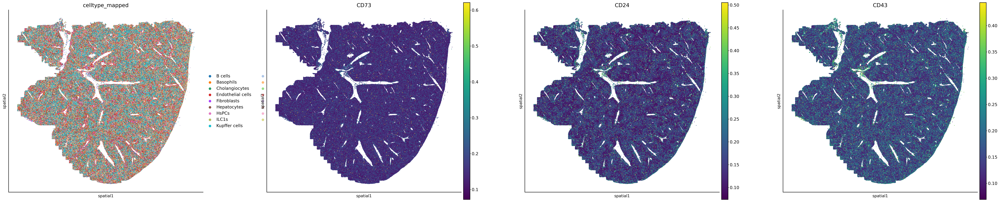

In [29]:
sq.pl.spatial_scatter(
    adata_spatial_prot,
    shape=None,
    color=["celltype_mapped", "CD73", "CD24", "CD43"],
    # groups="Neutrophils",
    size=1,
    figsize=(10, 10),
    dpi=300,
)

In [36]:
# df = problem.cell_transition(
#     source="src",
#     target="tgt",
#     source_groups="leiden",
#     target_groups="annot",
#     forward=True,
#     aggregation_mode="cell",
#     batch_size=1024,
# )
# df.shape
# adata_spatial_prot.shape

In [37]:
# df.to_csv(path_data / "cell_transition_score.csv.gz")

In [38]:
adata_spatial_prot.write(path_data / "adata_spatial_protein_out.h5ad")

adata_sc.write(path_data / "adata_sc_out.h5ad")

In [39]:
adata_spatial_gexp.write(path_data / "adata_spatial_gexp_out.h5ad")

In [40]:
adata_spatial.write(path_data / "adata_spatial_out.h5ad")

In [41]:
# sc.pl.umap(adata_sc, color=["Epcam", "Gja5", "annot"])